In [1]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os
from matplotlib.patches import Rectangle
import mpl_toolkits.mplot3d.art3d as art3d

In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))

# All alternations

## Prepare the chromosome info and data

In [3]:
hg38_chro_size = {'1': 248956422, '2':242193529, '3':198295559, '4':190214555, '5':181538259, '6':170805979,
                  '7': 159345973, '8':145138636, '9':138394717, '10':133797422, '11':135086622,
                  '12': 133275309, '13':114364328, '14':107043718, '15':101991189, '16':90338345,
                  '17':83257441, '18': 80373285, '19': 58617616, '20':64444167, '21':46709983,
                  '22':50818468, '23':156040895, '24':57227415}

In [357]:
bin_size = 1000000

In [358]:
hg38_chro = pd.DataFrame.from_dict(hg38_chro_size, orient='index', columns=['size'])
    

hg38_chro = hg38_chro.assign(bin= np.ceil(hg38_chro['size']/bin_size))

hg38_chro.index = hg38_chro.index.astype(int)

hg38_chro['tick'] = hg38_chro.apply(lambda x: 
                                   hg38_chro.loc[:x.name-1, 'bin'].sum() + 
                                   np.ceil(x['bin']/2), 
                               axis=1)  

hg38_chro['name'] = 'chr' + hg38_chro.index.astype(str)

hg38_chro['start'] = hg38_chro.apply(lambda x: 
                                   hg38_chro.loc[:x.name-1, 'bin'].sum(), 
                               axis=1)  

hg38_chro['end'] = hg38_chro.apply(lambda x: 
                                   hg38_chro.loc[:x.name, 'bin'].sum()-1, 
                               axis=1) 

In [6]:
hg38_chro

,size,bin,tick,name,start,end
1,248956422,249.0,125.0,chr1,0.0,248.0
2,242193529,243.0,371.0,chr2,249.0,491.0
3,198295559,199.0,592.0,chr3,492.0,690.0
4,190214555,191.0,787.0,chr4,691.0,881.0
5,181538259,182.0,973.0,chr5,882.0,1063.0
6,170805979,171.0,1150.0,chr6,1064.0,1234.0
7,159345973,160.0,1315.0,chr7,1235.0,1394.0
8,145138636,146.0,1468.0,chr8,1395.0,1540.0
9,138394717,139.0,1611.0,chr9,1541.0,1679.0
10,133797422,134.0,1747.0,chr10,1680.0,1813.0


## Prepare disease data

In [7]:
def file2record(f):
    df = pd.read_csv(f, sep='\t')
    return df

In [318]:
path = '/Users/bogao/DataFiles/new landscape/files'
amps = []
dels = []
names = []
min_samples = 50
for organ in os.scandir(path):
    if organ.is_dir():
        print(organ.name)
        
        with open(os.path.join(organ, '_'.join([organ.name.lower(), 'counts.tsv']))) as fc:
            counts = pd.read_csv(fc, sep='\t')
            print(counts)
        
        for subtype in os.scandir(os.path.abspath(organ)):
            if subtype.is_dir():
                print('\t{}'.format(subtype.name))
                
                if counts.loc[counts['name'] == subtype.name, 'count'].values[0] < min_samples:
                    print('\t\t Not enough samples: {}'.format(subtype.name))
                else:                
                
                
                    for f in os.scandir(os.path.abspath(subtype)):
                        if len(f.name.split('_')) == 4:
                            if 'amp_genes' in f.name:
                                print('\t\t{}'.format(f.name))
                                amps.append(file2record(f))
                                names.append('-'.join([organ.name, subtype.name]))
                            if 'del_genes' in f.name:
                                print('\t\t{}'.format(f.name))
                                dels.append(file2record(f))
                        

Skin
                   name  count
0          Bednar tumor     11
1  Epidermoid carcinoma     18
2          Keratinizing     11
3              Melanoma   1068
4         Not specified     50
5  Pagetoid reticulosis     32
	Bednar tumor
		 Not enough samples: Bednar tumor
	Melanoma
		skin_Melanoma_amp_genes.tsv
		skin_Melanoma_del_genes.tsv
	Keratinizing
		 Not enough samples: Keratinizing
	Epidermoid carcinoma
		 Not enough samples: Epidermoid carcinoma
	Pagetoid reticulosis
		 Not enough samples: Pagetoid reticulosis
Prostate
             name  count
0  Adenocarcinoma    916
1       Carcinoma     16
2   Not specified    253
	Carcinoma
		 Not enough samples: Carcinoma
	Adenocarcinoma
		prostate_Adenocarcinoma_del_genes.tsv
		prostate_Adenocarcinoma_amp_genes.tsv
Lung
                                                 name  count
0                               Acinar cell carcinoma     21
1                                      Adenocarcinoma   1212
2                             Adenosqua

## prepare amp data

In [22]:
xs = []
ys = []
zs = []
xd = []
yd = []
zd = []
colors = []
cm = plt.get_cmap('Set2')
num_colors = len(cm.colors)
i = 0
for df, y in zip(amps, np.arange(len(amps))):
#     if i >4:
#         break
    df['bin'] = df.apply(lambda x: 
                                   hg38_chro.loc[:x['chr']-1, 'bin'].sum() + 
                                   np.ceil(x['start']/bin_size), 
                               axis=1)     
    data = df.groupby(by='bin').mean()
    
    size = data.shape[0]
    
    xs += data.index.astype(int).tolist()
    ys += [y] * size
    zs += [0] * size

    xd += [0.8] * size 
    yd += [0.2] * size 
    zd += data['cnv_scaled'].tolist()
    
    colors += [cm.colors[i % num_colors]] * size
    i += 1

## plot amps

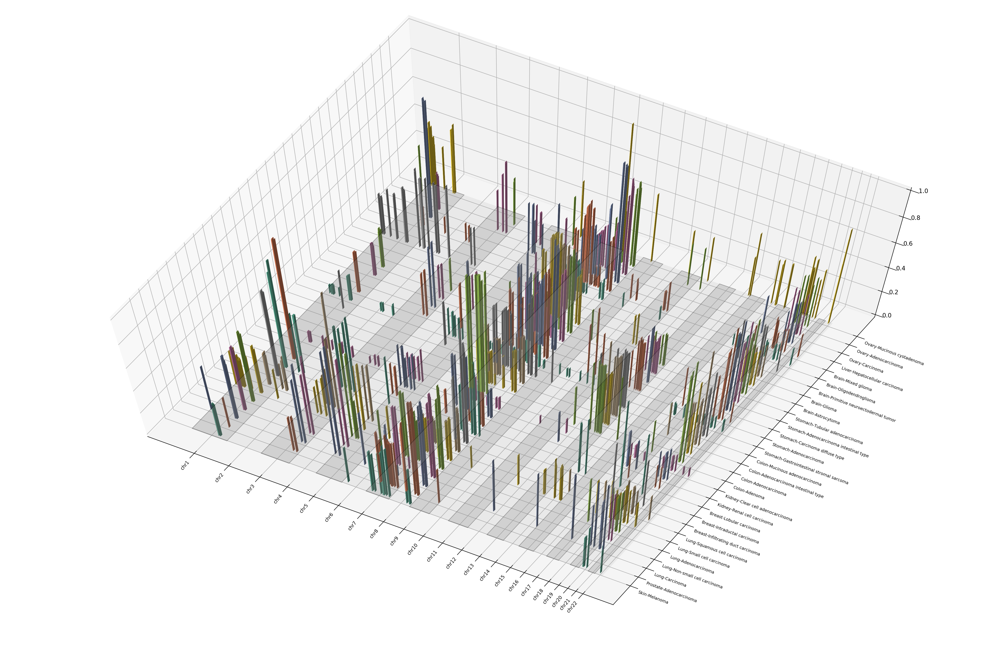

In [23]:
plt.rcParams['figure.dpi'] = 200
fig = plt.figure(figsize=(30,20))

ax = fig.add_subplot(111, projection='3d')


for j in range(1,23):
    if j % 2 == 1:
        p = Rectangle((hg38_chro.loc[j,'start'], -0.2), hg38_chro.loc[j,'bin']-1,i-0.6, fc='grey', alpha=0.3, ec='black')
    else:
        p = Rectangle((hg38_chro.loc[j,'start'], -0.2), hg38_chro.loc[j,'bin']-1,i-0.6, fc='grey', alpha=0.1)
    ax.add_patch(p)
    art3d.pathpatch_2d_to_3d(p, z=0, zdir="z")

ax.bar3d(xs, ys, zs, xd, yd, zd, color=colors)

# ax.set_xlabel('X')
# ax.set_ylabel('Y')
# ax.set_zlabel('Z')
ax.w_yaxis.set_ticks(range(i))
ax.w_yaxis.set_ticklabels(names[:i], rotation=-20, fontsize=7,
#                    verticalalignment='bottom',
                   horizontalalignment='left')

ax.w_xaxis.set_ticks(hg38_chro.loc[:22, 'tick'])
ax.w_xaxis.set_ticklabels(hg38_chro.loc[:22, 'name'], rotation=50, fontsize=8,
#                    verticalalignment='bottom',
                   horizontalalignment='right')

ele=ax.elev
ax.view_init(elev=ele+40)
plt.savefig('/Users/bogao/DataFiles/plots/newlandscape/bar3d_amp.pdf',bbox_inches='tight')

## prepare del data

In [12]:
xs = []
ys = []
zs = []
xd = []
yd = []
zd = []
colors = []
cm = plt.get_cmap('Set2')
num_colors = len(cm.colors)
i = 0
for df, y in zip(dels, np.arange(len(dels))):
#     if i >4:
#         break
    df['bin'] = df.apply(lambda x: 
                                   hg38_chro.loc[:x['chr']-1, 'bin'].sum() + 
                                   np.ceil(x['start']/bin_size), 
                               axis=1)     
    data = df.groupby(by='bin').mean()
    
    size = data.shape[0]
    
    xs += data.index.astype(int).tolist()
    ys += [y] * size
    zs += [0] * size

    xd += [0.8] * size 
    yd += [0.2] * size 
    zd += data['cnv_scaled'].tolist()
    
    colors += [cm.colors[i % num_colors]] * size
    i += 1

In [13]:
zd = np.abs(zd)

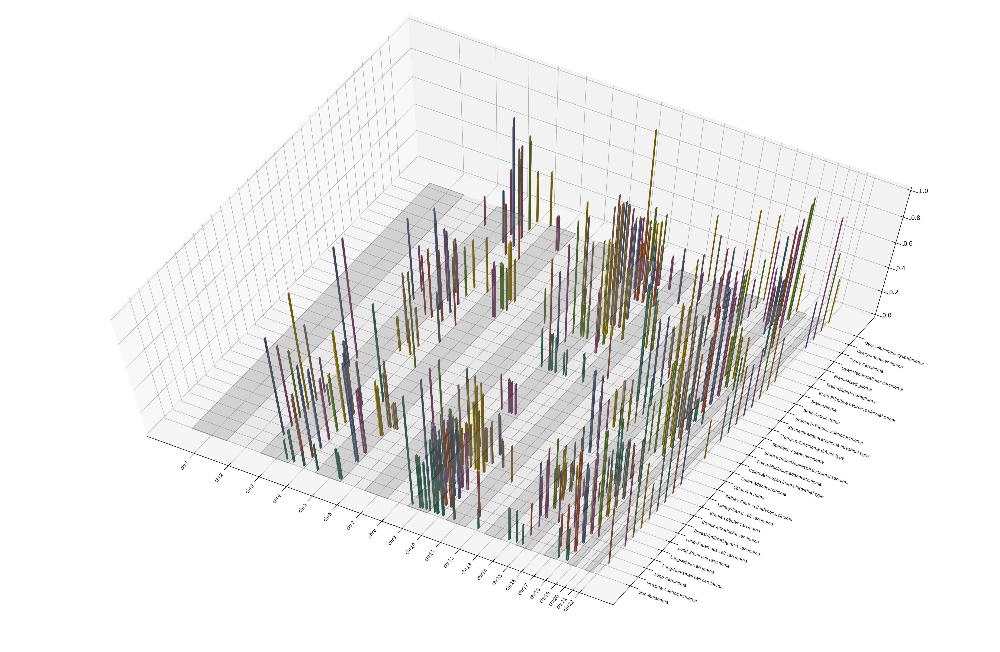

In [14]:
plt.rcParams['figure.dpi'] = 200
fig = plt.figure(figsize=(30,20))

ax = fig.add_subplot(111, projection='3d')


for j in range(1,23):
    if j % 2 == 1:
        p = Rectangle((hg38_chro.loc[j,'start'], -0.2), hg38_chro.loc[j,'bin']-1,i-0.6, fc='grey', alpha=0.3, ec='black')
    else:
        p = Rectangle((hg38_chro.loc[j,'start'], -0.2), hg38_chro.loc[j,'bin']-1,i-0.6, fc='grey', alpha=0.1)
    ax.add_patch(p)
    art3d.pathpatch_2d_to_3d(p, z=0, zdir="z")

ax.bar3d(xs, ys, zs, xd, yd, zd, color=colors)

# ax.set_xlabel('X')
# ax.set_ylabel('Y')
# ax.set_zlabel('Z')
ax.w_yaxis.set_ticks(range(i))
ax.w_yaxis.set_ticklabels(names[:i], rotation=-20, fontsize=7,
#                    verticalalignment='bottom',
                   horizontalalignment='left')

ax.w_xaxis.set_ticks(hg38_chro.loc[:22, 'tick'])
ax.w_xaxis.set_ticklabels(hg38_chro.loc[:22, 'name'], rotation=50, fontsize=8,
#                    verticalalignment='bottom',
                   horizontalalignment='right')

ele=ax.elev
ax.view_init(elev=ele+40)
plt.savefig('/Users/bogao/DataFiles/plots/newlandscape/bar3d_del.pdf',bbox_inches='tight')

# High level alternations

## prepare disease data

In [362]:
amps = []
dels = []
names = []
min_samples = 50
for organ in os.scandir(path):
    if organ.is_dir():
        print(organ.name)

        with open(os.path.join(organ, '_'.join([organ.name.lower(), 'counts.tsv']))) as fc:
            counts = pd.read_csv(fc, sep='\t')
            print(counts)        
        
        for subtype in os.scandir(os.path.abspath(organ)):
            if subtype.is_dir():
                print('\t{}'.format(subtype.name))
                    
                if counts.loc[counts['name'] == subtype.name, 'count'].values[0] < min_samples:
                    print('\t\t Not enough samples: {}'.format(subtype.name))
                else:                      
                    
                    for f in os.scandir(os.path.abspath(subtype)):
    #                     if len(f.name.split('_')) == 4:
                        if 'high_amp_genes' in f.name:
                            print('\t\t{}'.format(f.name))
                            amps.append(file2record(f))
                            names.append('-'.join([organ.name, subtype.name]))
                        if 'high_del_genes' in f.name:
                            print('\t\t{}'.format(f.name))
                            dels.append(file2record(f))

Skin
                   name  count
0          Bednar tumor     11
1  Epidermoid carcinoma     18
2          Keratinizing     11
3              Melanoma   1068
4         Not specified     50
5  Pagetoid reticulosis     32
	Bednar tumor
		 Not enough samples: Bednar tumor
	Melanoma
		skin_Melanoma_high_del_genes.tsv
		skin_Melanoma_high_amp_genes.tsv
	Keratinizing
		 Not enough samples: Keratinizing
	Epidermoid carcinoma
		 Not enough samples: Epidermoid carcinoma
	Pagetoid reticulosis
		 Not enough samples: Pagetoid reticulosis
Prostate
             name  count
0  Adenocarcinoma    916
1       Carcinoma     16
2   Not specified    253
	Carcinoma
		 Not enough samples: Carcinoma
	Adenocarcinoma
		prostate_Adenocarcinoma_high_amp_genes.tsv
		prostate_Adenocarcinoma_high_del_genes.tsv
Lung
                                                 name  count
0                               Acinar cell carcinoma     21
1                                      Adenocarcinoma   1212
2                  

## prepare amp data

In [104]:
xs = []
ys = []
zs = []
xd = []
yd = []
zd = []
colors = []
cm = plt.get_cmap('Set2')
num_colors = len(cm.colors)
i = 0
for df, y in zip(amps, np.arange(len(amps))):
#     if i >4:
#         break
    df['bin'] = df.apply(lambda x: 
                                   hg38_chro.loc[:x['chr']-1, 'bin'].sum() + 
                                   np.ceil(x['start']/bin_size), 
                               axis=1)     
    data = df.groupby(by='bin').mean()
    
    size = data.shape[0]
    
    xs += data.index.astype(int).tolist()
    ys += [y] * size
    zs += [0] * size

    xd += [15] * size 
    yd += [0.1] * size 
    zd += data['cnv_scaled'].tolist()
    
    colors += [cm.colors[i % num_colors]] * size
    i += 1

## plot

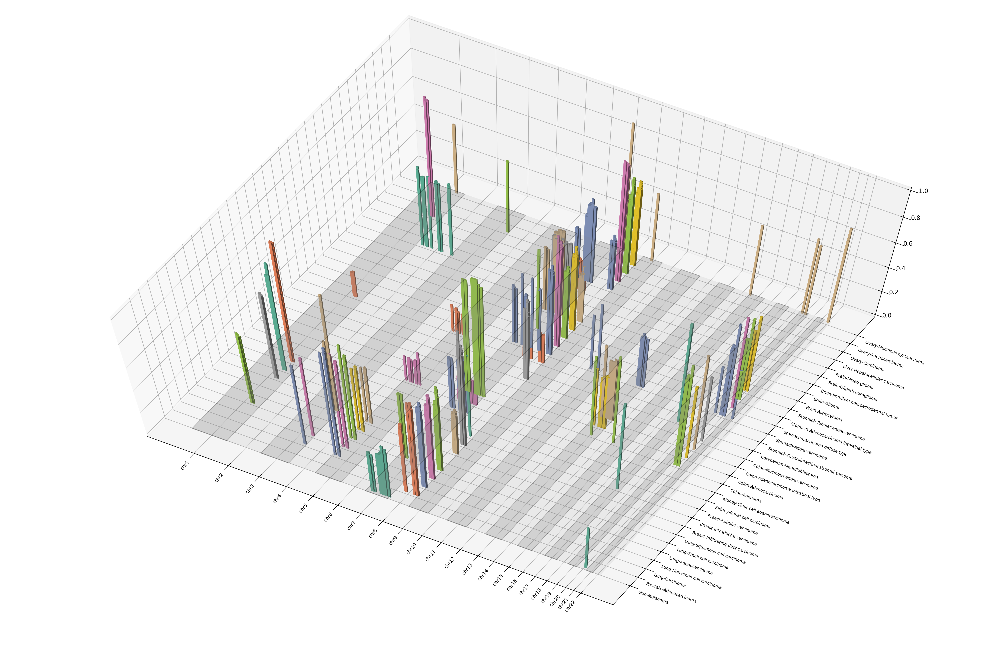

In [105]:
plt.rcParams['figure.dpi'] = 200
fig = plt.figure(figsize=(30,20))

ax = fig.add_subplot(111, projection='3d')


for j in range(1,23):
    if j % 2 == 1:
        p = Rectangle((hg38_chro.loc[j,'start'], -0.2), hg38_chro.loc[j,'bin']-1,i-0.6, fc='grey', alpha=0.3, ec='black')
    else:
        p = Rectangle((hg38_chro.loc[j,'start'], -0.2), hg38_chro.loc[j,'bin']-1,i-0.6, fc='grey', alpha=0.1)
    ax.add_patch(p)
    art3d.pathpatch_2d_to_3d(p, z=0, zdir="z")

ax.bar3d(xs, ys, zs, xd, yd, zd, color=colors)

# ax.set_xlabel('X')
# ax.set_ylabel('Y')
# ax.set_zlabel('Z')
ax.w_yaxis.set_ticks(range(i))
ax.w_yaxis.set_ticklabels(names[:i], rotation=-20, fontsize=7,
#                    verticalalignment='bottom',
                   horizontalalignment='left')

ax.w_xaxis.set_ticks(hg38_chro.loc[:22, 'tick'])
ax.w_xaxis.set_ticklabels(hg38_chro.loc[:22, 'name'], rotation=50, fontsize=8,
#                    verticalalignment='bottom',
                   horizontalalignment='right')

ele=ax.elev
ax.view_init(elev=ele+40)
# plt.savefig('/Users/bogao/DataFiles/plots/newlandscape/bar3d_high_amp.pdf',bbox_inches='tight')

## prepare del data

In [363]:
xs = []
ys = []
zs = []
xd = []
yd = []
zd = []
colors = []
cm = plt.get_cmap('Set2')
num_colors = len(cm.colors)
i = 0
for df, y in zip(dels, np.arange(len(dels))):
#     if i >4:
#         break
    df['bin'] = df.apply(lambda x: 
                                   hg38_chro.loc[:x['chr']-1, 'bin'].sum() + 
                                   np.ceil(x['start']/bin_size), 
                               axis=1)     
    data = df.groupby(by='bin').mean()
    
    size = data.shape[0]
    
    xs += data.index.astype(int).tolist()
    ys += [y] * size
    zs += [0] * size

    xd += [15] * size 
    yd += [0.2] * size 
    zd += data['cnv_scaled'].tolist()
    
    colors += [cm.colors[i % num_colors]] * size
    i += 1

In [364]:
zd = np.abs(zd)

## plot

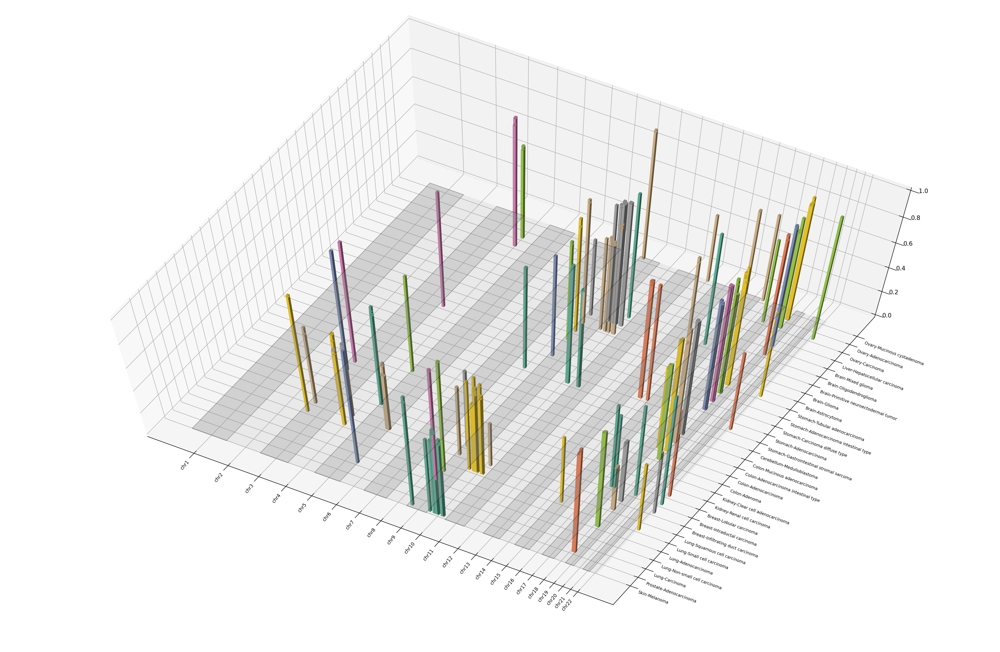

In [366]:
plt.rcParams['figure.dpi'] = 200
fig = plt.figure(figsize=(30,20))

ax = fig.add_subplot(111, projection='3d')


for j in range(1,23):
    if j % 2 == 1:
        p = Rectangle((hg38_chro.loc[j,'start'], -0.2), hg38_chro.loc[j,'bin']-1,i-0.6, fc='grey', alpha=0.3, ec='black')
    else:
        p = Rectangle((hg38_chro.loc[j,'start'], -0.2), hg38_chro.loc[j,'bin']-1,i-0.6, fc='grey', alpha=0.1)
    ax.add_patch(p)
    art3d.pathpatch_2d_to_3d(p, z=0, zdir="z")

ax.bar3d(xs, ys, zs, xd, yd, zd, color=colors)

# ax.set_xlabel('X')
# ax.set_ylabel('Y')
# ax.set_zlabel('Z')
ax.w_yaxis.set_ticks(range(i))
ax.w_yaxis.set_ticklabels(names[:i], rotation=-20, fontsize=7,
#                    verticalalignment='bottom',
                   horizontalalignment='left')

ax.w_xaxis.set_ticks(hg38_chro.loc[:22, 'tick'])
ax.w_xaxis.set_ticklabels(hg38_chro.loc[:22, 'name'], rotation=50, fontsize=8,
#                    verticalalignment='bottom',
                   horizontalalignment='right')

ele=ax.elev
ax.view_init(elev=ele+40)
plt.savefig('/Users/bogao/DataFiles/plots/newlandscape/bar3d_high_del.pdf',bbox_inches='tight')

In [19]:
i

59

# Plot subregions

## Chrom 7 high amps

In [3]:
hg38_chro_size = {'1': 248956422, '2':242193529, '3':198295559, '4':190214555, '5':181538259, '6':170805979,
                  '7': 159345973, '8':145138636, '9':138394717, '10':133797422, '11':135086622,
                  '12': 133275309, '13':114364328, '14':107043718, '15':101991189, '16':90338345,
                  '17':83257441, '18': 80373285, '19': 58617616, '20':64444167, '21':46709983,
                  '22':50818468, '23':156040895, '24':57227415}

In [223]:
bin_size = 100000000

In [224]:
hg38_chro = pd.DataFrame.from_dict(hg38_chro_size, orient='index', columns=['size'])
    

hg38_chro = hg38_chro.assign(bin= np.ceil(hg38_chro['size']/bin_size))

hg38_chro.index = hg38_chro.index.astype(int)

hg38_chro['tick'] = hg38_chro.apply(lambda x: 
                                   hg38_chro.loc[:x.name-1, 'bin'].sum() + 
                                   np.ceil(x['bin']/2), 
                               axis=1)  

hg38_chro['name'] = 'chr' + hg38_chro.index.astype(str)

hg38_chro['start'] = hg38_chro.apply(lambda x: 
                                   hg38_chro.loc[:x.name-1, 'bin'].sum(), 
                               axis=1)  

hg38_chro['end'] = hg38_chro.apply(lambda x: 
                                   hg38_chro.loc[:x.name, 'bin'].sum()-1, 
                               axis=1) 

In [294]:
xs = []
ys = []
zs = []
xd = []
yd = []
zd = []
colors = []
cm = plt.get_cmap('Set2')
num_colors = len(cm.colors)
i = 0
for df, y in zip(amps, np.arange(len(amps))):
#     if i >4:
#         break
    df['bin'] = df.apply(lambda x: 
                                   hg38_chro.loc[:x['chr']-1, 'bin'].sum() + 
                                   np.ceil(x['start']/bin_size), 
                               axis=1)     
    data = df.groupby(by='bin').mean()
    
    data = data[(data['chr'] == 7) | (data['chr'] == 8)]
    
    size = data.shape[0]
    
    ys += data.index.astype(int).tolist()
    xs += [y] * size
    zs += [0] * size

    yd += [0.1] * size 
    xd += [0.2] * size 
    zd += data['cnv_scaled'].tolist()
    
    colors += [cm.colors[i % num_colors]] * size
    i += 1
    
ys = [x-14.5 for x in ys]

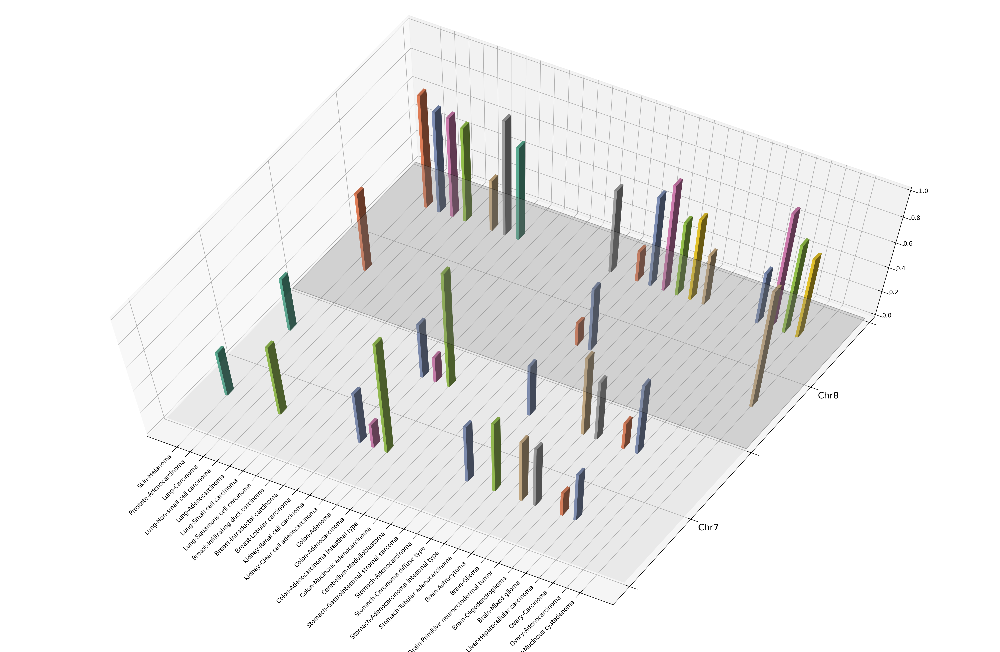

In [317]:
plt.rcParams['figure.dpi'] = 200
fig = plt.figure(figsize=(30,20))

ax = fig.add_subplot(111, projection='3d')


for j in np.arange(0, 4, 2):
    if j / 2 == 1:
        p = Rectangle((-2, j), i+3, 2, fc='grey', alpha=0.3, ec='black')
    else:
        p = Rectangle((-2, j), i+3, 2, fc='grey', alpha=0.1)
    ax.add_patch(p)
    art3d.pathpatch_2d_to_3d(p, z=0, zdir="z")

ax.bar3d(xs, ys, zs, xd, yd, zd, color=colors)

# ax.set_xlabel('X')
# ax.set_ylabel('Y')
# ax.set_zlabel('Z')
ax.w_xaxis.set_ticks(range(i))
ax.w_xaxis.set_ticklabels(names[:i], rotation=45, fontsize=10,
#                    verticalalignment='bottom',
                   horizontalalignment='right')

ax.w_yaxis.set_ticks(np.arange(0, 4.5, 1))
ylabels = [''] * 5
ylabels[1] = 'Chr7'
ylabels[3] = 'Chr8'
ax.w_yaxis.set_ticklabels(ylabels, rotation=0, fontsize=15,
#                    verticalalignment='bottom',
                   horizontalalignment='left')

ele=ax.elev
ax.view_init(elev=ele+40)
# plt.savefig('/Users/bogao/DataFiles/plots/newlandscape/bar3d_amp.pdf',bbox_inches='tight')

## Chro 7,8 all amps

In [349]:
bin_size = 1000000

In [350]:
hg38_chro = pd.DataFrame.from_dict(hg38_chro_size, orient='index', columns=['size'])
    

hg38_chro = hg38_chro.assign(bin= np.ceil(hg38_chro['size']/bin_size))

hg38_chro.index = hg38_chro.index.astype(int)

hg38_chro['tick'] = hg38_chro.apply(lambda x: 
                                   hg38_chro.loc[:x.name-1, 'bin'].sum() + 
                                   np.ceil(x['bin']/2), 
                               axis=1)  

hg38_chro['name'] = 'chr' + hg38_chro.index.astype(str)

hg38_chro['start'] = hg38_chro.apply(lambda x: 
                                   hg38_chro.loc[:x.name-1, 'bin'].sum(), 
                               axis=1)  

hg38_chro['end'] = hg38_chro.apply(lambda x: 
                                   hg38_chro.loc[:x.name, 'bin'].sum()-1, 
                               axis=1) 

In [355]:
xs = []
ys = []
zs = []
xd = []
yd = []
zd = []
colors = []
cm = plt.get_cmap('Set2')
num_colors = len(cm.colors)
i = 0
for df, y in zip(amps, np.arange(len(amps))):
#     if i >4:
#         break
    df['bin'] = df.apply(lambda x: 
                                   hg38_chro.loc[:x['chr']-1, 'bin'].sum() + 
                                   np.ceil(x['start']/bin_size), 
                               axis=1)     
    data = df.groupby(by='bin').mean()
    
    data = data[(data['chr'] == 7) | (data['chr'] == 8)]
    
    size = data.shape[0]
    
    ys += data.index.astype(int).tolist()
    xs += [y] * size
    zs += [0] * size

    yd += [0.1] * size 
    xd += [0.2] * size 
    zd += data['cnv_scaled'].tolist()
    
    colors += [cm.colors[i % num_colors]] * size
    i += 1
    
# ys = [x-14.5 for x in ys]

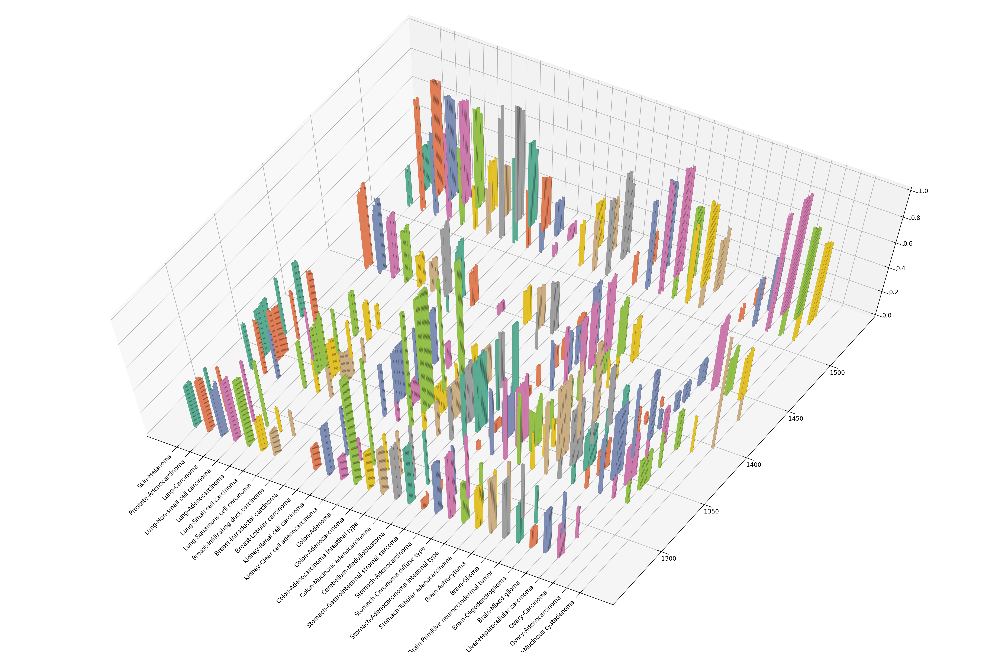

In [356]:
plt.rcParams['figure.dpi'] = 200
fig = plt.figure(figsize=(30,20))

ax = fig.add_subplot(111, projection='3d')


# for j in np.arange(0, 4, 2):
#     if j / 2 == 1:
#         p = Rectangle((-2, j), i+3, 2, fc='grey', alpha=0.3, ec='black')
#     else:
#         p = Rectangle((-2, j), i+3, 2, fc='grey', alpha=0.1)
#     ax.add_patch(p)
#     art3d.pathpatch_2d_to_3d(p, z=0, zdir="z")

ax.bar3d(xs, ys, zs, xd, yd, zd, color=colors)

# ax.set_xlabel('X')
# ax.set_ylabel('Y')
# ax.set_zlabel('Z')
ax.w_xaxis.set_ticks(range(i))
ax.w_xaxis.set_ticklabels(names[:i], rotation=45, fontsize=10,
#                    verticalalignment='bottom',
                   horizontalalignment='right')

# ax.w_yaxis.set_ticks(np.arange(0, 4.5, 1))
# ylabels = [''] * 5
# ylabels[1] = 'Chr7'
# ylabels[3] = 'Chr8'
# ax.w_yaxis.set_ticklabels(ylabels, rotation=0, fontsize=15,
# #                    verticalalignment='bottom',
#                    horizontalalignment='left')

ele=ax.elev
ax.view_init(elev=ele+40)
# plt.savefig('/Users/bogao/DataFiles/plots/newlandscape/bar3d_amp.pdf',bbox_inches='tight')

In [13]:
amps[2]

,gene_id,name,chr,start,end,symbol,band,cnv,cnv_scaled
0,ENSG00000196876,q13.13,12,51590266,51812864,SCN8A,12q13.13,30.53040,0.392601
1,ENSG00000170653,q13.13,12,53507856,53626410,ATF7,12q13.13,30.53160,0.392619
2,ENSG00000267281,q13.13,12,53506688,53625979,NaN,12q13.13,30.53160,0.392619
3,ENSG00000185591,q13.13,12,53380176,53416446,SP1,12q13.13,34.02010,0.445304
4,ENSG00000170374,q13.13,12,53326575,53345315,SP7,12q13.13,37.01060,0.490468
...,...,...,...,...,...,...,...,...,...
523,ENSG00000066827,q24.22,8,134477788,134713049,ZFAT,8q24.22,55.38480,0.767964
524,ENSG00000132297,q24.22,8,132061486,132111159,HHLA1,8q24.22,55.38190,0.767920
525,ENSG00000155926,q24.22,8,133036728,133102912,SLA,8q24.22,55.61190,0.771394
526,ENSG00000131773,q24.23,8,135457456,135656722,KHDRBS3,8q24.23,53.63140,0.741483


In [230]:
hg38_chro

,size,bin,tick,name,start,end
1,248956422,3.0,2.0,chr1,0.0,2.0
2,242193529,3.0,5.0,chr2,3.0,5.0
3,198295559,2.0,7.0,chr3,6.0,7.0
4,190214555,2.0,9.0,chr4,8.0,9.0
5,181538259,2.0,11.0,chr5,10.0,11.0
6,170805979,2.0,13.0,chr6,12.0,13.0
7,159345973,2.0,15.0,chr7,14.0,15.0
8,145138636,2.0,17.0,chr8,16.0,17.0
9,138394717,2.0,19.0,chr9,18.0,19.0
10,133797422,2.0,21.0,chr10,20.0,21.0


In [29]:
data[data['chr'] == 7]

,chr,start,end,cnv,cnv_scaled
bin,,,,,
3.0,7.0,2.494900e+06,2.536494e+06,3.537460,0.361385
4.0,7.0,3.599831e+06,3.658484e+06,3.407200,0.346636
5.0,7.0,4.654609e+06,4.792534e+06,3.772300,0.387977
10.0,7.0,9.622557e+06,9.670811e+06,4.207900,0.437300
11.0,7.0,1.044644e+07,1.052122e+07,4.166447,0.432607
...,...,...,...,...,...
2765.0,7.0,4.068585e+07,4.068924e+07,3.967500,0.410080
2766.0,7.0,4.124120e+07,4.133079e+07,3.967500,0.410080
2860.0,7.0,2.372670e+07,2.374788e+07,4.784976,0.502644


In [293]:
data

,chr,start,end,cnv,cnv_scaled
bin,,,,,
17.0,8.0,166049.0,167043.0,9.0644,0.98721


In [229]:
hg38_chro.loc[:22, 'tick']

1      2.0
2      5.0
3      7.0
4      9.0
5     11.0
6     13.0
7     15.0
8     17.0
9     19.0
10    21.0
11    23.0
12    25.0
13    27.0
14    29.0
15    31.0
16    33.0
17    34.0
18    35.0
19    36.0
20    37.0
21    38.0
22    39.0
Name: tick, dtype: float64

In [228]:
ys

[15,
 16,
 17,
 18,
 18,
 18,
 15,
 18,
 18,
 18,
 18,
 15,
 16,
 15,
 16,
 15,
 16,
 18,
 17,
 18,
 15,
 16,
 17,
 18,
 18,
 15,
 18,
 18,
 15,
 16,
 18,
 15,
 16,
 15,
 16,
 15,
 16,
 18,
 18,
 18,
 18,
 17]

In [236]:
i

31

In [306]:
np.arange(0, 4, 2)

array([0, 2])

In [277]:
xs

[0,
 0,
 1,
 1,
 2,
 3,
 4,
 4,
 6,
 7,
 8,
 10,
 10,
 11,
 11,
 12,
 12,
 15,
 17,
 17,
 18,
 18,
 18,
 18,
 19,
 20,
 20,
 21,
 22,
 22,
 22,
 23,
 23,
 25,
 25,
 26,
 26,
 26,
 27,
 28,
 29,
 30]

In [289]:
ys

[1,
 2,
 3,
 4,
 4,
 4,
 1,
 4,
 4,
 4,
 4,
 1,
 2,
 1,
 2,
 1,
 2,
 4,
 3,
 4,
 1,
 2,
 3,
 4,
 4,
 1,
 4,
 4,
 1,
 2,
 4,
 1,
 2,
 1,
 2,
 1,
 2,
 4,
 4,
 4,
 4,
 3]